<a href="https://colab.research.google.com/github/sankalp69/Health-Insurance-Cross-Sell-Prediction/blob/main/Health_Insurance_Cross_Sell_Prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Project Name**    - Health Insurance Cross Sell Prediction



##### **Project Type**    - EDA/Regression/Classification/Unsupervised
##### **Contribution**    - Individual/Team
##### **Team Member 1 -**
##### **Team Member 2 -**
##### **Team Member 3 -**
##### **Team Member 4 -**

# **Project Summary -**


Our client is an Insurance company that has provided Health Insurance to its customers now they
need your help in building a model to predict whether the policyholders (customers) from past year
will also be interested in Vehicle Insurance provided by the company.
An insurance policy is an arrangement by which a company undertakes to provide a guarantee of
compensation for specified loss, damage, illness, or death in return for the payment of a specified
premium. A premium is a sum of money that the customer needs to pay regularly to an insurance
company for this guarantee.
For example, you may pay a premium of Rs. 5000 each year for a health insurance cover of Rs.
200,000/- so that if, God forbid, you fall ill and need to be hospitalised in that year, the insurance
provider company will bear the cost of hospitalisation etc. for upto Rs. 200,000. Now if you are
wondering how can company bear such high hospitalisation cost when it charges a premium of
only Rs. 5000/-, that is where the concept of probabilities comes in picture. For example, like you,
there may be 100 customers who would be paying a premium of Rs. 5000 every year, but only a few
of them (say 2-3) would get hospitalised that year and not everyone. This way everyone shares the

risk of everyone else.
Just like medical insurance, there is vehicle insurance where every year customer needs to pay a
premium of certain amount to insurance provider company so that in case of unfortunate accident
by the vehicle, the insurance provider company will provide a compensation (called ‘sum assured’)
to the customer

# **GitHub Link -**

Provide your GitHub Link here.

# **Problem Statement**


# **General Guidelines** : -  

1.   Well-structured, formatted, and commented code is required.
2.   Exception Handling, Production Grade Code & Deployment Ready Code will be a plus. Those students will be awarded some additional credits.
     
     The additional credits will have advantages over other students during Star Student selection.
       
             [ Note: - Deployment Ready Code is defined as, the whole .ipynb notebook should be executable in one go
                       without a single error logged. ]

3.   Each and every logic should have proper comments.
4. You may add as many number of charts you want. Make Sure for each and every chart the following format should be answered.
        

```
# Chart visualization code
```
            

*   Why did you pick the specific chart?
*   What is/are the insight(s) found from the chart?
* Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

5. You have to create at least 15 logical & meaningful charts having important insights.


[ Hints : - Do the Vizualization in  a structured way while following "UBM" Rule.

U - Univariate Analysis,

B - Bivariate Analysis (Numerical - Categorical, Numerical - Numerical, Categorical - Categorical)

M - Multivariate Analysis
 ]





6. You may add more ml algorithms for model creation. Make sure for each and every algorithm, the following format should be answered.


*   Explain the ML Model used and it's performance using Evaluation metric Score Chart.


*   Cross- Validation & Hyperparameter Tuning

*   Have you seen any improvement? Note down the improvement with updates Evaluation metric Score Chart.

*   Explain each evaluation metric's indication towards business and the business impact pf the ML model used.




















# ***Let's Begin !***

## ***1. Know Your Data***

### Import Libraries

In [96]:
# Import Libraries

# Basic
import numpy as np
import pandas as pd

# Plotation
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
%matplotlib inline

# ML Models
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
import lightgbm as lgb

# Evaluation Metrics
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import log_loss

# Hyper Parameter Tuning
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.experimental import enable_halving_search_cv
from sklearn.model_selection import HalvingRandomSearchCV

# Miscellaneous
import time
from imblearn.over_sampling import SMOTE
from sklearn.preprocessing import MinMaxScaler
from sklearn.feature_selection import mutual_info_classif
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split
from sklearn.ensemble import ExtraTreesClassifier
import warnings
warnings.filterwarnings('ignore')

### Dataset Loading

In [97]:
# Connecting to Drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [118]:
# Load Dataset
data_df = pd.read_csv('/content/drive/MyDrive/train.csv', encoding='unicode_escape')
model_df = data_df.copy()

### Dataset First View

In [99]:
# Dataset First Look
data_df

,id,Gender,Age,Driving_License,Region_Code,Previously_Insured,Vehicle_Age,Vehicle_Damage,Annual_Premium,Policy_Sales_Channel,Vintage,Response
0,1,Male,44,1,28.0,0,> 2 Years,Yes,40454.0,26.0,217,1
1,2,Male,76,1,3.0,0,1-2 Year,No,33536.0,26.0,183,0
2,3,Male,47,1,28.0,0,> 2 Years,Yes,38294.0,26.0,27,1
3,4,Male,21,1,11.0,1,< 1 Year,No,28619.0,152.0,203,0
4,5,Female,29,1,41.0,1,< 1 Year,No,27496.0,152.0,39,0
...,...,...,...,...,...,...,...,...,...,...,...,...
381104,381105,Male,74,1,26.0,1,1-2 Year,No,30170.0,26.0,88,0
381105,381106,Male,30,1,37.0,1,< 1 Year,No,40016.0,152.0,131,0
381106,381107,Male,21,1,30.0,1,< 1 Year,No,35118.0,160.0,161,0
381107,381108,Female,68,1,14.0,0,> 2 Years,Yes,44617.0,124.0,74,0


### Dataset Rows & Columns count

In [100]:
# Dataset Rows & Columns count
rows = data_df.shape[0]
columns = data_df.shape[1]
print(f"Dataset have {rows} number of rows. ")
print(f"Dataset have {columns} number of columns. ")

Dataset have 381109 number of rows. 
Dataset have 12 number of columns. 


### Dataset Information

In [101]:
# Dataset Info
data_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 381109 entries, 0 to 381108
Data columns (total 12 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   id                    381109 non-null  int64  
 1   Gender                381109 non-null  object 
 2   Age                   381109 non-null  int64  
 3   Driving_License       381109 non-null  int64  
 4   Region_Code           381109 non-null  float64
 5   Previously_Insured    381109 non-null  int64  
 6   Vehicle_Age           381109 non-null  object 
 7   Vehicle_Damage        381109 non-null  object 
 8   Annual_Premium        381109 non-null  float64
 9   Policy_Sales_Channel  381109 non-null  float64
 10  Vintage               381109 non-null  int64  
 11  Response              381109 non-null  int64  
dtypes: float64(3), int64(6), object(3)
memory usage: 34.9+ MB


#### Duplicate Values

In [102]:
# Dataset Duplicate Value Count
df_dup = data_df.duplicated().sum()
print(f"Dataset have {df_dup} number of duplicate values. ")

Dataset have 0 number of duplicate values. 


#### Missing Values/Null Values

In [103]:
# Missing Values/Null Values Count
print(f" Missing Values/Null Values Count is ")
print(f"{data_df.isnull().sum()}")

 Missing Values/Null Values Count is 
id                      0
Gender                  0
Age                     0
Driving_License         0
Region_Code             0
Previously_Insured      0
Vehicle_Age             0
Vehicle_Damage          0
Annual_Premium          0
Policy_Sales_Channel    0
Vintage                 0
Response                0
dtype: int64


<Axes: >

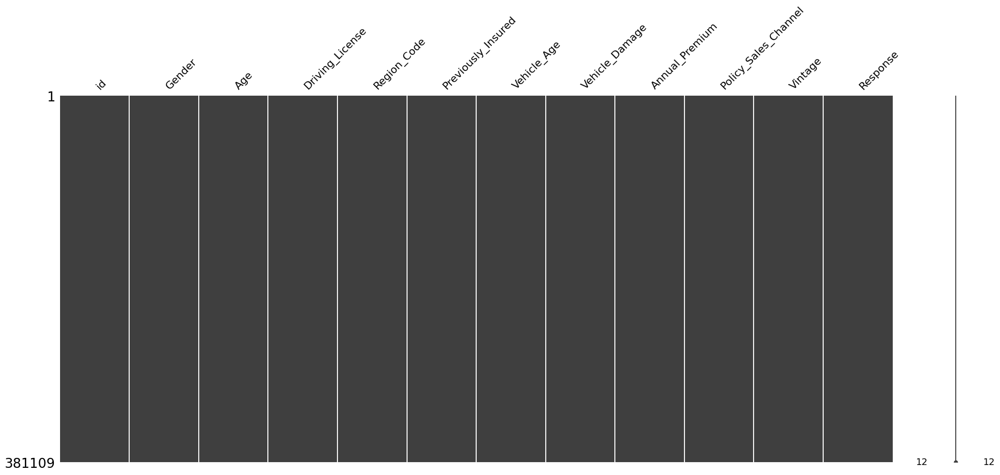

In [104]:
# Visualizing the missing values
msno.matrix(data_df)

### What did you know about your dataset?

Columns:
ID: Unique identifier for the Customer.

Age: Age of the Customer.

Gender: Gender of the Customer.

Driving_License: 0 for customer not having DL, 1 for customer having DL.

Region_Code: Unique code for the region of the customer.

Previously_Insured: 0 for customer not having vehicle insurance, 1 for customer having vehicle insurance.

Vehicle_Age: Age of the vehicle.

Vehicle_Damage: Customer got his/her vehicle damaged in the past. 0 : Customer didn't get his/her vehicle damaged in the past.

Annual_Premium: The amount customer needs to pay as premium in the year.

Policy_Sales_Channel: Anonymized Code for the channel of outreaching to the customer ie. Different Agents, Over Mail, Over Phone, In Person, etc.

Vintage: Number of Days, Customer has been associated with the company.

Response (Dependent Feature): 1 for Customer is interested, 0 for Customer is not interested.

## ***2. Understanding Your Variables***

In [105]:
# Dataset Columns
data_df.columns

Index(['id', 'Gender', 'Age', 'Driving_License', 'Region_Code',
       'Previously_Insured', 'Vehicle_Age', 'Vehicle_Damage', 'Annual_Premium',
       'Policy_Sales_Channel', 'Vintage', 'Response'],
      dtype='object')

In [106]:
# Dataset Describe
data_df.describe().T

,count,mean,std,min,25%,50%,75%,max
id,381109.0,190555.000000,110016.836208,1.0,95278.0,190555.0,285832.0,381109.0
Age,381109.0,38.822584,15.511611,20.0,25.0,36.0,49.0,85.0
Driving_License,381109.0,0.997869,0.046110,0.0,1.0,1.0,1.0,1.0
Region_Code,381109.0,26.388807,13.229888,0.0,15.0,28.0,35.0,52.0
Previously_Insured,381109.0,0.458210,0.498251,0.0,0.0,0.0,1.0,1.0
Annual_Premium,381109.0,30564.389581,17213.155057,2630.0,24405.0,31669.0,39400.0,540165.0
Policy_Sales_Channel,381109.0,112.034295,54.203995,1.0,29.0,133.0,152.0,163.0
Vintage,381109.0,154.347397,83.671304,10.0,82.0,154.0,227.0,299.0
Response,381109.0,0.122563,0.327936,0.0,0.0,0.0,0.0,1.0


### Variables Description

ID: Unique identifier for the Customer.

Age: Age of the Customer.

Gender: Gender of the Customer.

Driving_License: 0 for customer not having DL, 1 for customer having DL.

Region_Code: Unique code for the region of the customer.

Previously_Insured: 0 for customer not having vehicle insurance, 1 for customer having vehicle insurance.

Vehicle_Age: Age of the vehicle.

Vehicle_Damage: Customer got his/her vehicle damaged in the past. 0 : Customer didn't get his/her vehicle damaged in the past.

Annual_Premium: The amount customer needs to pay as premium in the year.

Policy_Sales_Channel: Anonymized Code for the channel of outreaching to the customer ie. Different Agents, Over Mail, Over Phone, In Person, etc.

Vintage: Number of Days, Customer has been associated with the company.

Response (Dependent Feature): 1 for Customer is interested, 0 for Customer is not interested.

Answer Here

### Check Unique Values for each variable.



In [107]:
# Check Unique Values for each variable.
for column in data_df.columns:
    unique_values = data_df[column].unique()
    print(f"Unique values in column '{column}': {unique_values}")

Unique values in column 'id': [     1      2      3 ... 381107 381108 381109]
Unique values in column 'Gender': ['Male' 'Female']
Unique values in column 'Age': [44 76 47 21 29 24 23 56 32 41 71 37 25 42 60 65 49 34 51 26 57 79 48 45
 72 30 54 27 38 22 78 20 39 62 58 59 63 50 67 77 28 69 52 31 33 43 36 53
 70 46 55 40 61 75 64 35 66 68 74 73 84 83 81 80 82 85]
Unique values in column 'Driving_License': [1 0]
Unique values in column 'Region_Code': [28.  3. 11. 41. 33.  6. 35. 50. 15. 45.  8. 36. 30. 26. 16. 47. 48. 19.
 39. 23. 37.  5. 17.  2.  7. 29. 46. 27. 25. 13. 18. 20. 49. 22. 44.  0.
  9. 31. 12. 34. 21. 10. 14. 38. 24. 40. 43. 32.  4. 51. 42.  1. 52.]
Unique values in column 'Previously_Insured': [0 1]
Unique values in column 'Vehicle_Age': ['> 2 Years' '1-2 Year' '< 1 Year']
Unique values in column 'Vehicle_Damage': ['Yes' 'No']
Unique values in column 'Annual_Premium': [ 40454.  33536.  38294. ...  20706. 101664.  69845.]
Unique values in column 'Policy_Sales_Channel': [ 26. 1

## ***3. Data Vizualization, Storytelling & Experimenting with charts : Understand the relationships between variables***

#### Chart - 1 Age Vs Resopnse

In [108]:
# Chart - 1 visualization code
def Age_Vs_Resopnse(df):
    fig1 = px.histogram(df, x='Age', color='Response',
                        title='Age Distribution by Response',
                        labels={'Age': 'Age', 'count': 'Count', 'Response': 'Response'},
                        barmode="group")
    fig1.show()
Age_Vs_Resopnse(data_df)

##### 1. Why did you pick the specific chart?

There are a few reasons why a bar chart might be a good choice for this kind of data. First, it is categorical data, meaning it falls into distinct groups (age groups in this case). Bar charts are well-suited for comparing  different categories.

Second, the data is not continuous. The age groups are not measured on a scale that goes on forever.  Bar charts are a good choice for data that is measured in discrete units.

Finally, there are not too many categories. Bar charts can become difficult to read if there are too many categories to compare. In this case, there are only a few age groups.

##### 2. What is/are the insight(s) found from the chart?

From above plot we can see that young people below 30 are not interested in vehicle insurance.

People aged between 30-60 are more likely to be interested

one of the reason can be - Lack of perceived value:

Some young people may not see the value of purchasing vehicle insurance, particularly if they have never been in an accident or have had any issues with their vehicle.

another reason may be " overconvidence"


##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Young drivers may feel overconfident in their driving skills and believe that they are less likely to get into an accident, which may lead them to avoid purchasing vehicle insurance.



#### Chart - 2 Region Code Distribution by Response

In [109]:
# Chart - 2 visualization code
def Region_Code_Distribution_by_response(df):
    fig1 = px.histogram(df, x='Region_Code', color='Response', title='Region Code Distribution by Response', barmode="group")
    fig1.show()
Region_Code_Distribution_by_response(data_df)

##### 1. Why did you pick the specific chart?
Bar charts are a good choice for comparing categories, which is what this chart is doing. Each region code has a bar, and the height of the bar shows the number of responses for that region.

Answer Here.

##### 2. What is/are the insight(s) found from the chart?

Area code 28 has the most health insurance clients and region code 51 has the fewest



##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Comapany can focus on region which have less insurance and try to gain market share.

#### Chart - 3 Vehicle Age by Response

In [110]:
# Chart - 3 visualization code
def Vehicle_Age_by_Response(df):
    fig1 = px.histogram(df, x='Vehicle_Age', color='Response', title='Vehicle_Age by Response')
    fig1.show()
Vehicle_Age_by_Response(data_df)

##### 1. Why did you pick the specific chart?

The chart effectively displays the counts of vehicles within each age group ('2 Years', '1-2 Year', etc.) broken down by response category ('Yes' and 'No'). This is ideal for comparing response distributions across different vehicle age groups.

##### 2. What is/are the insight(s) found from the chart?

Consumers with 1-2-year-old vehicles are more interested as compared to others.


*   Consumers with less than 1 year old Vehicles have very less chance of buying Insurance
*   Consumers with 1-2-year-old vehicles are more interested as compared to others.



##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

comapny can focus on

#### Chart - 4 Vehicle Damage by Response

In [111]:
# Chart - 4 visualization code
def Vehicle_Damage_by_Response(df):
    fig1 = px.histogram(df, x='Vehicle_Damage', color='Response', title='Vehicle_Damage by Response')
    fig1.show()
Vehicle_Damage_by_Response(data_df)

##### 1. Why did you pick the specific chart?

This chart effectively communicates the distribution of responses based on vehicle damage status, highlighting the trend that vehicles with damage are more likely to receive negative responses. It provides a clear visual comparison between the two categories, making it easy to observe the differences in response distribution.

##### 2. What is/are the insight(s) found from the chart?

There is a general trend of more negative responses across both categories of vehicle damage status.However, the proportion of negative responses is notably higher in the "Yes" category compared to the "No" category.Vehicle damage appears to have a significant impact on the response, with damaged vehicles receiving more negative responses.Comparing the two categories, we can infer that the presence of vehicle damage correlates with a higher number of negative responses.

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

If veichele is damaged in most of the case responce from inshurence company is no .

#### Chart - 5 Gender v/s Response

In [112]:
# Chart - 5 visualization code
def Gender_Response(df):
    fig1 = px.histogram(df, x='Gender', color='Response', title='Gender by Response')
    fig1.show()
Gender_Response(data_df)

##### 1. Why did you pick the specific chart?

The chart shows a clear difference in the distribution of responses between males and females. It seems there are more positive responses from females than males (represented by the green color on top of the stacked bars).

##### 2. What is/are the insight(s) found from the chart?

The chart shows a clear difference in the distribution of responses between males and females. It seems there are more positive responses from females than males

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Male category is somewhat more noteworthy than that of female and chances of purchasing the insurance is likewise minimal high

#### Chart - 6 Driving License v/s Response

In [113]:
# Chart - 6 visualization
def Driving_License_Response(df):
    fig1 = px.histogram(df, x='Driving_License', color='Response', title='Driving_License by Response')
    fig1.show()
Driving_License_Response(data_df)

##### 1. Why did you pick the specific chart?

The chart likely visualizes the distribution of responses (1 and 0, which likely represent different response categories) for people who have or don't have a driving license.

##### 2. What is/are the insight(s) found from the chart?

There might be a correlation between having a driver's license and the type of response. The chart likely shows separate counts (or percentages) of visitors who responded with "Yes", "No", or something similar, categorized by whether they have a driver's license or not.

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

We can see that if there is a license holder than it will be more likely to buy an insurance.Also there is very less count of People who donot have driving license.

#### Chart - 7

In [114]:
# Chart - 7 visualization code

# Chart - 7 visualization code

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

def show_age_relations(df):
    # Create subplots
    fig = make_subplots(rows=1, cols=3, subplot_titles=('Age_Group', 'Age_Group V/S Previously_Insured'))

    # Plot 1: Countplot for Response and Age_Group
    count_plot = px.histogram(
        df,
        x="Response",
        color="Age_Group",
        barmode='group',
        color_discrete_sequence=px.colors.qualitative.Pastel
    )
    for trace in count_plot.data:
        fig.add_trace(trace, row=1, col=1)

    # Plot 2: Histplot for Age_Group and Previously_Insured
    hist_plot = px.histogram(
        df,
        x="Age_Group",
        color="Previously_Insured",
        barmode='stack',
        # Use a valid value for histnorm, or remove it if not needed
        histnorm='probability'
    )
    for trace in hist_plot.data:
        fig.add_trace(trace, row=1, col=2)

    # Update axis titles and plot titles
    fig.update_xaxes(title_text='Response', row=1, col=1)
    fig.update_yaxes(title_text='Count', row=1, col=1)
    fig.update_xaxes(title_text='Age_Group', row=1, col=2)
    fig.update_yaxes(title_text='Count', row=1, col=2)
    fig.update_xaxes(title_text='Age', row=1, col=3)

    fig.show()

# Example usage
show_age_relations(data_df)



ValueError: Value of 'color' is not the name of a column in 'data_frame'. Expected one of ['id', 'Gender', 'Age', 'Driving_License', 'Region_Code', 'Previously_Insured', 'Vehicle_Age', 'Vehicle_Damage', 'Annual_Premium', 'Policy_Sales_Channel', 'Vintage', 'Response'] but received: Age_Group

##### 1. Why did you pick the specific chart?

Answer Here.

##### 2. What is/are the insight(s) found from the chart?

Answer Here

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Answer Here

#### Chart - 8

In [ ]:
# Chart - 8 visualization code
def age_group_distribution(df):

    # Create Age_Group column
    df['Age_Group'] = df['Age'].apply(lambda x: 'YoungAge' if 20 <= x <= 45 else 'MiddleAge' if 45 < x <= 65 else 'OldAge')

    # Create subplots
    fig = sp.make_subplots(rows=1, cols=3, specs=[[{'type':'domain'}, {'type':'domain'}, {'type':'domain'}]],
                           subplot_titles=('with Response', 'with Annual_Premium', 'with Previously_Insured'))

    # With Response
    response_data = df.groupby('Age_Group')['Response'].sum().reset_index()
    fig.add_trace(go.Pie(labels=response_data['Age_Group'], values=response_data['Response'], name="Response"), 1, 1)

    # With Annual_Premium
    premium_data = df.groupby('Age_Group')['Annual_Premium'].sum().reset_index()
    fig.add_trace(go.Pie(labels=premium_data['Age_Group'], values=premium_data['Annual_Premium'], name="Annual_Premium"), 1, 2)

    # With Previously_Insured
    insured_data = df.groupby('Age_Group')['Previously_Insured'].sum().reset_index()
    fig.add_trace(go.Pie(labels=insured_data['Age_Group'], values=insured_data['Previously_Insured'], name="Previously_Insured"), 1, 3)

    # Update layout
    fig.update_layout(title_text='Age Group Distribution',
                      title_font_size=20,
                      title_font_family='bold')

    fig.show()

age_group_distribution(data_df)

##### 1. Why did you pick the specific chart?

Answer Here.

##### 2. What is/are the insight(s) found from the chart?

Answer Here

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Answer Here

#### Chart - 9

In [ ]:
def plot_annual_premium_distribution(df):
    # Create subplots
    fig = make_subplots(rows=2, cols=1, subplot_titles=('Annual premium distribution', 'Annual premium vs response'))

    # Plotting distplot for annual premium
    fig.add_trace(
        go.Histogram(
            x=df['Annual_Premium'],
            nbinsx=100,
        ),
        row=1, col=1
    )

    # Plotting hist plot and response distribution
    fig.add_trace(
        go.Histogram(
            x=df['Annual_Premium'],
            nbinsx=200,
            opacity=0.75
        ),
        row=2, col=1
    )

    fig.add_trace(
        go.Histogram(
            x=df['Annual_Premium'][df['Response'] == 1],
            nbinsx=200,
            opacity=0.75
        ),
        row=2, col=1
    )

    # Update layout
    fig.update_layout(
        title_text="Annual Premium Analysis",
        height=800,
        width=1700
    )

    fig.update_xaxes(title_text="Annual Premium", row=1, col=1)
    fig.update_xaxes(title_text="Annual Premium", row=2, col=1)
    fig.update_yaxes(title_text="Count", row=1, col=1)
    fig.update_yaxes(title_text="Count", row=2, col=1)

    fig.show()

plot_annual_premium_distribution(data_df)

##### 1. Why did you pick the specific chart?

Answer Here.

##### 2. What is/are the insight(s) found from the chart?

Answer Here

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Answer Here

#### Chart - 10

In [ ]:
# Chart - 10 visualization code
def show_region_code_distribution(df):

    colors = sns.color_palette('pastel')[0:4]
    explode = (0.01, 0.01, 0.01)

    fig, axes = plt.subplots(1,2, figsize=(15,6))
    axes[0].pie(x=df.groupby('Region_Code_Categorical')['Vintage'].sum(),explode=explode,
                labels=data_df['Region_Code_Categorical'].unique(), colors=colors,autopct='%1.1f%%',
                shadow=True);
    axes[0].set_title('with Vintage', fontsize = 15, fontweight ='bold', pad=15)

    axes[1].pie(x=df.groupby('Region_Code_Categorical')['Annual_Premium_Treated'].sum(),explode=explode,
                labels=data_df['Region_Code_Categorical'].unique(), colors=colors, autopct='%1.1f%%',
                shadow=True);
    axes[1].set_title('with Annual_Premium', fontsize = 15, fontweight ='bold', pad=15)

    plt.suptitle('Region Code Distribution',fontsize = 15, fontweight ='bold')


show_region_code_distribution(data_df)

In [ ]:
# Chart - 10 visualization code
def show_age_annual_premium_relation(df):
    fig = px.scatter(df, x="Age", y="Annual_Premium",
                    color="Region_Code_Categorical",
                    size_max=180,opacity=0.3, title='Age V/S Annual Premium')
    fig.show()

show_age_annual_premium_relation(data_df)

##### 1. Why did you pick the specific chart?

Answer Here.

##### 2. What is/are the insight(s) found from the chart?

Answer Here

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Answer Here

#### Chart - 11 Vintage feature vs Responce

In [ ]:
# Chart - 11 visualization code
def vintage_responce(df):
    fig= plt.subplots(figsize = (20,6))
    sns.histplot( x=df['Vintage'],color="#bcbddc", kde = True)
    sns.histplot( x=df['Vintage'][df['Response'] == 1], color = '#756bb1', kde = True)
    plt.show()

vintage_responce(data_df)

##### 1. Why did you pick the specific chart?

Answer Here.

##### 2. What is/are the insight(s) found from the chart?

Answer Here

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Answer Here

#### Chart - 12

In [ ]:
# Chart - 12 visualization code

##### 1. Why did you pick the specific chart?

Answer Here.

##### 2. What is/are the insight(s) found from the chart?

Answer Here

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Answer Here

#### Chart - 13

In [ ]:
# Chart - 13 visualization code

##### 1. Why did you pick the specific chart?

Answer Here.

##### 2. What is/are the insight(s) found from the chart?

Answer Here

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Answer Here

#### Chart - 14 - Correlation Heatmap

In [ ]:
# Correlation Heatmap visualization code
def Correlation(df):
  df_numeric = df.select_dtypes(include=['number'])
  corr = df_numeric.corr()
  trace = go.Heatmap(z=corr.values,x=corr.index.values,y=corr.columns.values)
  fig = go.Figure()
  fig.add_trace(trace)
  fig.show()

Correlation(data_df)


##### 1. Why did you pick the specific chart?

Answer Here.

##### 2. What is/are the insight(s) found from the chart?

Answer Here

#### Chart - 15 - Pair Plot

In [ ]:
# Pair Plot visualization code

##### 1. Why did you pick the specific chart?

Answer Here.

##### 2. What is/are the insight(s) found from the chart?

Answer Here

## ***5. Hypothesis Testing***

### Based on your chart experiments, define three hypothetical statements from the dataset. In the next three questions, perform hypothesis testing to obtain final conclusion about the statements through your code and statistical testing.

Answer Here.

### Hypothetical Statement - 1

#### 1. State Your research hypothesis as a null hypothesis and alternate hypothesis.

Answer Here.

#### 2. Perform an appropriate statistical test.

In [ ]:
# Perform Statistical Test to obtain P-Value

##### Which statistical test have you done to obtain P-Value?

Answer Here.

##### Why did you choose the specific statistical test?

Answer Here.

### Hypothetical Statement - 2

#### 1. State Your research hypothesis as a null hypothesis and alternate hypothesis.

Answer Here.

#### 2. Perform an appropriate statistical test.

In [ ]:
# Perform Statistical Test to obtain P-Value

##### Which statistical test have you done to obtain P-Value?

Answer Here.

##### Why did you choose the specific statistical test?

Answer Here.

### Hypothetical Statement - 3

#### 1. State Your research hypothesis as a null hypothesis and alternate hypothesis.

Answer Here.

#### 2. Perform an appropriate statistical test.

In [ ]:
# Perform Statistical Test to obtain P-Value

##### Which statistical test have you done to obtain P-Value?

Answer Here.

##### Why did you choose the specific statistical test?

Answer Here.

## ***6. Feature Engineering & Data Pre-processing***

### 1. Handling Missing Values

In [ ]:
# Handling Missing Values & Missing Value Imputation

#### What all missing value imputation techniques have you used and why did you use those techniques?

Answer Here.

### 2. Handling Outliers

In [119]:
# Handling Outliers & Outlier treatments

def show_outlier(df):
    # Create a figure with subplots
    fig = make_subplots(rows=2, cols=3, subplot_titles=('Annual Premium', 'Age', 'Vintage'))

    # Boxplot for Annual Premium
    fig.add_trace(
        go.Box(y=df['Annual_Premium'], x=df['Response'], boxmean=True, name='Annual Premium'),
        row=1, col=1)

    # Boxplot for Age
    fig.add_trace(
        go.Box(y=df['Age'], x=df['Response'], boxmean=True, name='Age'),
        row=1, col=2)

    # Boxplot for Vintage
    fig.add_trace(
        go.Box(y=df['Vintage'], x=df['Response'], boxmean=True, name='Vintage'),
        row=1, col=3)

    # Distribution plot for Annual Premium
    fig.add_trace(
        go.Histogram(x=df['Annual_Premium'], histnorm='density', name='Annual Premium', marker_color='lightblue'),
        row=2, col=1)

    # Distribution plot for Age
    fig.add_trace(
        go.Histogram(x=df['Age'], histnorm='density', name='Age', marker_color='lightblue'),
        row=2, col=2)

    # Distribution plot for Vintage
    fig.add_trace(
        go.Histogram(x=df['Vintage'], histnorm='density', name='Vintage', marker_color='lightblue'),
        row=2, col=3)

    # Update x and y axis labels
    fig.update_xaxes(title_text='Response', row=1, col=1)
    fig.update_xaxes(title_text='Response', row=1, col=2)
    fig.update_xaxes(title_text='Response', row=1, col=3)
    fig.update_xaxes(title_text='Annual Premium', row=2, col=1)
    fig.update_xaxes(title_text='Age', row=2, col=2)
    fig.update_xaxes(title_text='Vintage', row=2, col=3)

    fig.update_yaxes(title_text='Annual Premium', row=1, col=1)
    fig.update_yaxes(title_text='Age', row=1, col=2)
    fig.update_yaxes(title_text='Vintage', row=1, col=3)
    fig.update_yaxes(title_text='Density', row=2, col=1)
    fig.update_yaxes(title_text='Density', row=2, col=2)
    fig.update_yaxes(title_text='Density', row=2, col=3)

    # Update title
    fig.update_layout(title_text='Outliers', title_font_size=28, title_x=0.5)

    # Show the plot
    fig.show()

show_outlier(model_df)

##### What all outlier treatment techniques have you used and why did you use those techniques?

Answer Here.

##Outlier Treatment and Feature Scaling

In [120]:
def outlier_treatment(df):
    Q1=df['Annual_Premium'].quantile(0.25)
    Q3=df['Annual_Premium'].quantile(0.75)
    IQR=Q3-Q1

    Lower_Whisker = Q1-1.5*IQR
    Upper_Whisker = Q3+1.5*IQR
    df['Annual_Premium_Treated'] = np.where(df['Annual_Premium']>Upper_Whisker, Upper_Whisker, df['Annual_Premium'])

def scale_features(df):
    scaler = MinMaxScaler()

    df['Annual_Premium_Treated'] = scaler.fit_transform(df['Annual_Premium_Treated'].values.reshape(-1,1))
    df['Vintage_Treated'] = scaler.fit_transform(df['Vintage'].values.reshape(-1,1))

outlier_treatment(model_df)
scale_features(model_df)

In [121]:
def show_ann_prem_outliers(df):
    fig = px.box(df, y='Annual_Premium_Treated', x='Response',
                 title='Annual Premium Treated',
                 labels={'Annual_Premium_Treated': 'Annual Premium Treated', 'Response': 'Response'})
    fig.update_layout(font=dict(size=14))

    fig2 = px.histogram(df, x='Annual_Premium_Treated',
                        title='Annual Premium Treated',
                        labels={'Annual_Premium_Treated': 'Annual Premium Treated', 'Density': 'Density'})
    fig2.update_layout(font=dict(size=14))

    fig.show()
    fig2.show()

show_ann_prem_outliers(model_df)


### 3. Categorical Encoding

In [122]:
#Encoding numerical columns to categorcial
#we will use both label as well as one hot encoding for transformation of data type
le = LabelEncoder()
ohe = OneHotEncoder()

#mapping
model_df["Vehicle_Age"]=data_df["Vehicle_Age"].map({"> 2 Years":2,"1-2 Year":1,"< 1 Year":0})


#categorical to numerical
model_df['Gender'] = ohe.fit_transform(data_df[["Gender"]]).toarray()
model_df['Vehicle_Age'] = le.fit_transform(data_df[['Vehicle_Age']])
model_df['Vehicle_Damage'] = le.fit_transform(data_df[['Vehicle_Damage']])

In [123]:
model_df.head()

,id,Gender,Age,Driving_License,Region_Code,Previously_Insured,Vehicle_Age,Vehicle_Damage,Annual_Premium,Policy_Sales_Channel,Vintage,Response,Annual_Premium_Treated,Vintage_Treated
0,1,0.0,44,1,28.0,0,2,1,40454.0,26.0,217,1,0.638245,0.716263
1,2,0.0,76,1,3.0,0,0,0,33536.0,26.0,183,0,0.521510,0.598616
2,3,0.0,47,1,28.0,0,2,1,38294.0,26.0,27,1,0.601797,0.058824
3,4,0.0,21,1,11.0,1,1,0,28619.0,152.0,203,0,0.438540,0.667820
4,5,1.0,29,1,41.0,1,1,0,27496.0,152.0,39,0,0.419591,0.100346


#### What all categorical encoding techniques have you used & why did you use those techniques?

Answer Here.

### Seprating dependent and independent variables


In [124]:
x=model_df.drop(['Response'],axis=1) #  contain all  independent variable
y=model_df['Response']               #  dependent variable

### 4. Feature Manipulation & Selection

#### 1. Feature Manipulation

In [126]:
# Manipulate Features to minimize feature correlation and create new features
# Create an Extra Trees classifier with 50 trees
etc = ExtraTreesClassifier(n_estimators=50)
# Fit the model on the data
etc.fit(x, y)

# Compute feature importances
importances = etc.feature_importances_
fig = go.Figure(data=[go.Bar(x=x.columns, y=importances)])

# Rotate x-axis labels for better readability
fig.update_layout(xaxis_tickangle=90)

# Add axis labels and title (optional)
fig.update_layout(
    xaxis_title="Features",
    yaxis_title="Importance",
    title="Feature Importances",)

# Display the plot
fig.show()

From above plot we can see that less important features are " Gender and Driving License" from the data set



#### 2. Feature Selection

In [127]:
# Select your features wisely to avoid overfitting
model_df.drop(['Gender','Driving_License'],axis=1 ,inplace=True)

##### What all feature selection methods have you used  and why?

Answer Here.

##### Which all features you found important and why?

Answer Here.

### 5. Data Transformation

#### Do you think that your data needs to be transformed? If yes, which transformation have you used. Explain Why?

In [128]:
# Transform Your data
scaler = MinMaxScaler()
data_df = scaler.fit_transform(model_df)
data_df

array([[0.00000000e+00, 3.69230769e-01, 5.38461538e-01, ...,
        1.00000000e+00, 6.38245096e-01, 7.16262976e-01],
       [2.62392813e-06, 8.61538462e-01, 5.76923077e-02, ...,
        0.00000000e+00, 5.21510230e-01, 5.98615917e-01],
       [5.24785625e-06, 4.15384615e-01, 5.38461538e-01, ...,
        1.00000000e+00, 6.01797089e-01, 5.88235294e-02],
       ...,
       [9.99994752e-01, 1.53846154e-02, 5.76923077e-01, ...,
        0.00000000e+00, 5.48205020e-01, 5.22491349e-01],
       [9.99997376e-01, 7.38461538e-01, 2.69230769e-01, ...,
        0.00000000e+00, 7.08491879e-01, 2.21453287e-01],
       [1.00000000e+00, 4.00000000e-01, 5.57692308e-01, ...,
        0.00000000e+00, 6.60569500e-01, 7.85467128e-01]])

### 6. Data Scaling

In [ ]:
# Scaling your data

##### Which method have you used to scale you data and why?

###7. Dimesionality Reduction

##### Do you think that dimensionality reduction is needed? Explain Why?

Answer Here.

In [ ]:
# DImensionality Reduction (If needed)

### 8. Handling Imbalanced Dataset

##### Do you think the dataset is imbalanced? Explain Why.

Answer Here.

In [129]:
# Handling Imbalanced Dataset
smote = SMOTE()

# fit predictor and target variable
x, y = smote.fit_resample(x,y)


print('Original dataset shape', len(model_df))
print('Resampled dataset shape', len(y))

Original dataset shape 381109
Resampled dataset shape 668798


##### What technique did you use to handle the imbalance dataset and why? (If needed to be balanced)

Answer Here.

### 9. Data Splitting

In [130]:
# Splitting the dataset into training and testing
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=0.30,random_state = 10)

In [131]:
# Checking balanced data for train dataset
y_train.value_counts()

Response
1    234126
0    234032
Name: count, dtype: int64

##### What data splitting ratio have you used and why?

Answer Here.

In [ ]:
# Split your data to train and test. Choose Splitting ratio wisely.


## ***7. ML Model Implementation***

### ML Model - 1 LogisticRegression

In [132]:
# ML Model - 1 Implementation
lr = LogisticRegression()
lr.fit(x_train,y_train)
y_pred = lr.predict(x_test)

# Fit the Algorithm

# Predict on the model
acc_lr= accuracy_score(y_test,y_pred)
recall_lr = recall_score(y_test,y_pred)
precision_lr = precision_score(y_test,y_pred)
f1score_lr= f1_score(y_test,y_pred)

print("Accuracy Score : ",acc_lr)
print("Recall Score : ",recall_lr)
print("Precision Score : ",precision_lr)
print("F1 Score : ",f1score_lr)

Accuracy Score :  0.599466706539075
Recall Score :  0.5471562634009155
Precision Score :  0.61083277666444
F1 Score :  0.5772437701546085


In [ ]:
def plot_confusion_matrix_and_roc_curves(model, X_test, y_test, y_pred):

    fig, axes = plt.subplots(1,2, figsize=(22,5))

    cm = confusion_matrix(y_test, y_pred)
    group_names = ['True Neg','False Pos','False Neg','True Pos']
    group_counts = ['{0:0.0f}'.format(value) for value in
                    cm.flatten()]
    group_percentages = ['{0:.2%}'.format(value) for value in
                        cm.flatten()/np.sum(cm)]
    labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
            zip(group_names,group_counts,group_percentages)]
    labels = np.asarray(labels).reshape(2,2)

    sns.heatmap(cm, ax = axes[0], annot=labels, fmt='',cmap='Blues')
    axes[0].set_title('Confusion Matrix', fontdict={'fontsize': 16, 'fontweight':'bold'})

    # predict probabilities
    pred_proba = model.predict_proba(X_test)

    # roc curve for models
    fpr, tpr, thresh = roc_curve(y_test, pred_proba[:,1], pos_label=1)

    # roc curve for tpr = fpr
    random_probs = [0 for i in range(len(y_test))]
    p_fpr, p_tpr, _ = roc_curve(y_test, random_probs, pos_label=1)

    plt.subplot(1, 2, 2)
    # plot roc curves
    plt.plot(fpr, tpr,linestyle='--',color='red', label = type(model).__name__)

    plt.plot(p_fpr, p_tpr, linestyle='-', color='blue')
    # title
    plt.title('ROC curve', fontdict={'fontsize': 16, 'fontweight':'bold'})
    # x label
    plt.xlabel('False Positive Rate', fontdict={'fontsize': 12})
    # y label
    plt.ylabel('True Positive rate', fontdict={'fontsize': 12})

    plt.legend(loc='best')
    plt.show()

#### 1. Explain the ML Model used and it's performance using Evaluation metric Score Chart.

In [ ]:
# Visualizing evaluation Metric Score chart

#### 2. Cross- Validation & Hyperparameter Tuning

In [133]:
# ML Model - 1 Implementation with hyperparameter optimization techniques (i.e., GridSearch CV, RandomSearch CV, Bayesian Optimization etc.)
param_grid = [
    {'penalty' : ['l1', 'l2', 'elasticnet'],
    'C' : np.logspace(-4, 4, 20),
    'solver' : ['lbfgs','newton-cg'],
    'max_iter' : [100, 1000,2500]}
    ]
# Fit the Algorithm
clf = RandomizedSearchCV(lr, param_grid, cv=2, verbose=True, n_jobs=-1)
best_clf = clf.fit(x_train,y_train)
# Predict on the model
best_clf = clf.fit(x_train,y_train)
y_pred = best_clf.predict(x_test)

acc_lr= accuracy_score(y_test,y_pred)
recall_lr = recall_score(y_test,y_pred)
precision_lr = precision_score(y_test,y_pred)
f1score_lr= f1_score(y_test,y_pred)


Fitting 2 folds for each of 10 candidates, totalling 20 fits
Fitting 2 folds for each of 10 candidates, totalling 20 fits


In [134]:
best_lr_reg = clf.fit(x,y)

Fitting 2 folds for each of 10 candidates, totalling 20 fits


In [135]:
print("Accuracy Score : ",acc_lr)
print("Recall Score : ",recall_lr)
print("Precision Score : ",precision_lr)
print("F1 Score : ",f1score_lr)

Accuracy Score :  0.8885616028708134
Recall Score :  0.8724781346922901
Precision Score :  0.901378557151394
F1 Score :  0.8866929169770589


[[90795  9572]
 [12787 87486]]


<Axes: >

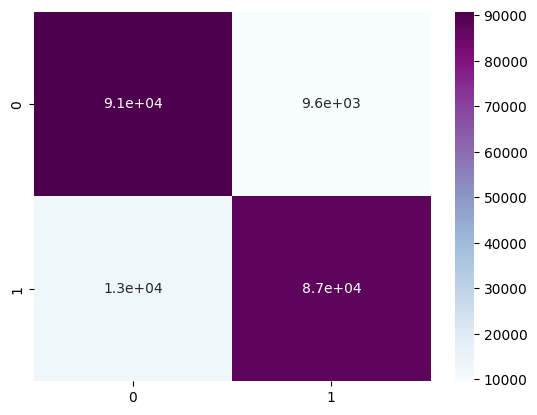

In [136]:
cm = confusion_matrix(y_test,y_pred)
print(cm)
sns.heatmap(cm,annot=True,cmap='BuPu')

In [137]:
AUC_LR=roc_auc_score(y_pred,y_test)
print("ROC_AUC Score of Logistic regression is :",AUC_LR)

ROC_AUC Score of Logistic regression is : 0.8889652338575028


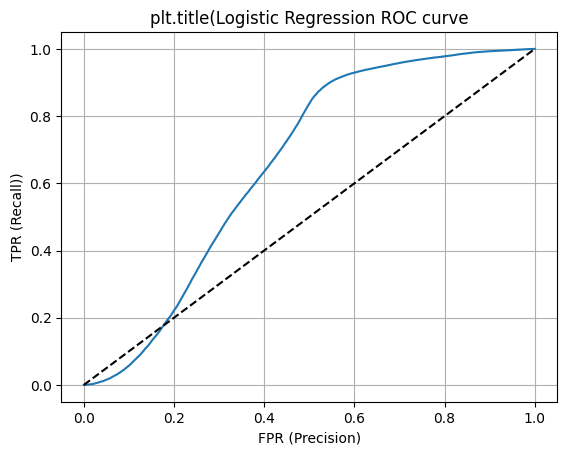

In [138]:
# Get probability estimates for test set
y_score = lr.predict_proba(x_test)[:, 1]

# Get true binary labels for test set
y_true = y_test

# Set pos_label to 1 since we are working with a binary classification problem
pos_label = 1

fpr, tpr, thresholds = roc_curve(y_true, y_score, pos_label=1)

plt.title('plt.title(Logistic Regression ROC curve')
plt.xlabel('FPR (Precision)')
plt.ylabel('TPR (Recall))')
plt.xlabel('FPR (Precision)')



plt.plot(fpr,tpr)
plt.plot((0,1), ls='dashed',color='black')
plt.grid(True)
plt.show()

##### Which hyperparameter optimization technique have you used and why?

Answer Here.

##### Have you seen any improvement? Note down the improvement with updates Evaluation metric Score Chart.

Answer Here.

### ML Model - 2 DecisionTreeClassifier

In [139]:
# ML Model - 2 Implementation
dtree = DecisionTreeClassifier()
dtree = dtree.fit(x_train, y_train)
dtree_pred = dtree.predict(x_test)
dtree_probability =dtree.predict_proba(x_test)[:,1]
# Fit the Algorithm

# Predict on the model
acc_dtree = accuracy_score(y_test,dtree_pred)
recall_dtree = recall_score(y_test,dtree_pred)
prec_dtree = precision_score(y_test,dtree_pred)
f1score_dtree=f1_score(y_test,dtree_pred)


print("Accuracy Score : ",acc_dtree)
print("Recall Score : ",recall_dtree)
print("Precision Score : ",prec_dtree)
print("F1 Score : ",f1score_dtree)

Accuracy Score :  0.8864583333333333
Recall Score :  0.8914363786861867
Precision Score :  0.8825556367370313
F1 Score :  0.8869737788692913


#### 1. Explain the ML Model used and it's performance using Evaluation metric Score Chart.

In [ ]:
# Visualizing evaluation Metric Score chart

#### 2. Cross- Validation & Hyperparameter Tuning

In [164]:
# ML Model - 1 Implementation with hyperparameter optimization techniques (i.e., GridSearch CV, RandomSearch CV, Bayesian Optimization etc.)

parameters_decision_tree = {"splitter":["best","random"],
            "max_depth" : [None,5,7,9],
           "min_samples_leaf":[1,2,3,4,5],
           "min_weight_fraction_leaf":[0.0, 0.3,0.4,0.5],
           "max_features":["auto","log2","sqrt",None],
           "max_leaf_nodes":[None,30,40,50,60],
           'random_state':[23]}

# Fit the Algorithm

clf = RandomizedSearchCV(dtree, parameters_decision_tree, cv=2, verbose=True, n_jobs=-1)
best_dtree = clf.fit(x_train,y_train)

# Predict on the model
best_clf = clf.fit(x_train,y_train)
y_pred = best_clf.predict(x_test)

acc_dtree= accuracy_score(y_test,y_pred)
recall_dtree = recall_score(y_test,y_pred)
precision_dtree = precision_score(y_test,y_pred)
f1score_dtree= f1_score(y_test,y_pred)

Fitting 2 folds for each of 10 candidates, totalling 20 fits
Fitting 2 folds for each of 10 candidates, totalling 20 fits


In [165]:
best_dtree = clf.fit(x,y)

Fitting 2 folds for each of 10 candidates, totalling 20 fits


In [166]:
print("Accuracy Score : ",acc_dtree)
print("Recall Score : ",recall_dtree)
print("Precision Score : ",precision_dtree)
print("F1 Score : ",f1score_dtree)

Accuracy Score :  0.8364832535885167
Recall Score :  0.9171561636731722
Precision Score :  0.7896313977349807
F1 Score :  0.8486296945649165


##### Which hyperparameter optimization technique have you used and why?

Answer Here.

##### Have you seen any improvement? Note down the improvement with updates Evaluation metric Score Chart.

Answer Here.

#### 3. Explain each evaluation metric's indication towards business and the business impact pf the ML model used.

Answer Here.

## ***8.*** ***Future Work (Optional)***

### 1. Save the best performing ml model in a pickle file or joblib file format for deployment process.


In [ ]:
# Save the File

### 2. Again Load the saved model file and try to predict unseen data for a sanity check.


In [ ]:
# Load the File and predict unseen data.

### ***Congrats! Your model is successfully created and ready for deployment on a live server for a real user interaction !!!***

# **Conclusion**

Write the conclusion here.

### ***Hurrah! You have successfully completed your Machine Learning Capstone Project !!!***